## Hackathon
1. Create a team (3-4 people)
2. Perform the following:
    1. **Data Wrangling - Cleaning & Merging**: Make data usable for analysis.
    2. **Feature Engineering**: Make new features or change the current features
    3. **Feature Selection**: Choose the best features
    4. **Model Design**: Design and implement the model
    5. **Model Evaluation**: Evaluate the model

## Submission Guideline
The output expected at the end of this hackathon is:
1. One **Jupyter notebook** containing all analysis performed using Python.
2. One **PowerPoint** presentation containing the analysis results. Each group will be allocated 15-20 minutes (inclusive of Q&A) to present their analysis results to the class.
3. One **Final Dataset** - Based on the selected features for training & testing the model (in csv format)


## Presentation Guideline



**Note(s):**
1. Only **one submission** is required per group.
2. Include full details in your notebook and **report only important results** in your presentation.
3. Please only use Jupyter notebook (SQL/pandas) to clean the data (Do not clean manually using Excel)

## Business Problem:

***One of the global banks would like to understand what factors drive credit card spending in order to set a proper credit limit. To solve this problem, the bank conducted a survey of 5000 customers and collected data.
The objective of this capstone is to understand what is driving the total spend (Primary Card + Secondary card). Given the variables, predict the credit limit for new applicants***


## Data Availability:

- Data for the case are available in xlsx format(Data Set.xlxs).
- The data have been provided for 5000 customers.
- Detailed data dictionary has been provided for understanding the data.
- Data is encoded in numerical format to reduce the size of the data however some of the variables are categorical. You can  find the details in the data dictionary.


## Data Dictonary

For data dictonary follow the "Data Dictionary.xlxs"

## 1. Import necessary Packages

In [2]:
# import relevant modules
import sys
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import statsmodels.formula.api as sn
import scipy.stats as stats
from matplotlib.backends.backend_pdf import PdfPages
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from statsmodels.stats.outliers_influence import variance_inflation_factor
from patsy import dmatrices
%matplotlib inline

# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

# Settings
pd.set_option('display.max_columns', None)
np.set_printoptions(threshold=sys.maxsize)
np.set_printoptions(precision=3)
sns.set(style="darkgrid")
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

## 2. Load and Inspect Data

In [3]:
customers_df = pd.read_excel("Data Set.xlsx")

In [5]:
customers_df.sample(3)

,custid,region,townsize,gender,age,agecat,birthmonth,ed,edcat,jobcat,union,employ,empcat,retire,income,lninc,inccat,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,default,jobsat,marital,spoused,spousedcat,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,homeown,hometype,address,addresscat,cars,carown,cartype,carvalue,carcatvalue,carbought,carbuy,commute,commutecat,commutetime,commutecar,commutemotorcycle,commutecarpool,commutebus,commuterail,commutepublic,commutebike,commutewalk,commutenonmotor,telecommute,reason,polview,polparty,polcontrib,vote,card,cardtype,cardbenefit,cardfee,cardtenure,cardtenurecat,card2,card2type,card2benefit,card2fee,card2tenure,card2tenurecat,cardspent,card2spent,active,bfast,tenure,churn,longmon,lnlongmon,longten,lnlongten,tollfree,tollmon,lntollmon,tollten,lntollten,equip,equipmon,lnequipmon,equipten,lnequipten,callcard,cardmon,lncardmon,cardten,lncardten,wireless,wiremon,lnwiremon,wireten,lnwireten,multline,voice,pager,internet,callid,callwait,forward,confer,ebill,owntv,hourstv,ownvcr,owndvd,owncd,ownpda,ownpc,ownipod,owngame,ownfax,news,response_01,response_02,response_03
4780,9396-TEWFMY-BZ3,5,1.0,0,74,6,November,10,1,2,1,8,3,1,9,2.197225,1,23.7,0.379674,-0.968442,1.753326,0.561515,0,2,0,-1,-1,1,0,0,0,0,0,0,0,0,0,2,6,2,2,0,1,5.3,1,1,0,1,1,24.0,1,0,0,1,0,0,0,0,0,0,2,5,0,0,1,2,4,2,0,6,3,1,1,2,0,3,2,264.49,149.10,1,1,17,1,10.90,2.388763,238.95,5.476254,1,15.50,2.740840,321.6,5.773309,0,0.0,NaN,0.0,NaN,1,4.25,1.446919,75.0,4.317488,0,0.0,NaN,0.0,NaN,0,0,1,0,1,1,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0
421,3957-CXVHIS-5IC,1,2.0,0,26,3,October,16,3,2,0,1,1,0,40,3.688879,2,17.4,2.916240,1.070295,4.043760,1.397175,0,2,0,-1,-1,5,11,0,1,0,0,0,0,10,0,2,3,2,1,1,1,21.5,2,0,0,8,4,32.0,0,0,1,1,0,0,0,1,0,0,9,3,0,0,1,2,4,2,0,9,3,3,1,4,0,7,3,471.74,109.88,1,3,26,1,7.20,1.974081,187.60,5.234312,1,19.25,2.957511,470.7,6.154221,0,0.0,NaN,0.0,NaN,1,12.75,2.545531,340.0,5.828946,0,0.0,NaN,0.0,NaN,0,0,0,0,1,0,1,1,0,1,20,1,1,1,0,0,1,1,0,0,0,0,0
3135,7021-YMULAX-N03,4,5.0,0,73,6,August,12,2,6,0,32,5,1,39,3.663562,2,15.2,3.456024,1.240119,2.471976,0.905018,0,5,1,13,2,2,7,0,0,0,0,0,0,7,1,1,38,5,3,1,1,17.6,1,0,0,1,1,29.0,1,0,0,1,0,0,0,1,0,1,9,4,0,0,0,4,4,2,0,37,5,2,1,1,1,24,5,292.77,147.81,0,3,69,0,15.75,2.756840,1147.95,7.045733,1,51.25,3.936716,3577.5,8.182420,0,0.0,NaN,0.0,NaN,1,23.75,3.167583,1625.0,7.393263,0,0.0,NaN,0.0,NaN,1,0,0,0,0,1,1,0,0,1,28,1,1,1,0,0,0,0,0,1,0,0,0


In [6]:
customers_df.columns

Index(['custid', 'region', 'townsize', 'gender', 'age', 'agecat', 'birthmonth',
       'ed', 'edcat', 'jobcat',
       ...
       'owncd', 'ownpda', 'ownpc', 'ownipod', 'owngame', 'ownfax', 'news',
       'response_01', 'response_02', 'response_03'],
      dtype='object', length=130)

## 3. Data Wrangling

### 3.1 Merge/Clean Data
- Do whatever is necessary to prepare the data for data analysis
- Use SQL/pandas for data merging
- Clean the data using jupyter notebook

Note: Do not clean data manually using excel

In [4]:
# To create Y we need to sum up cardspent(first card spent amount) and card2spent(Second card spent amount)
# total_spent=cardspent + card2spent
customers_df['totalSpent'] = customers_df['cardspent'] + customers_df['card2spent']

In [8]:
# Show the data again with the new Y column added
customers_df.columns

Index(['custid', 'region', 'townsize', 'gender', 'age', 'agecat', 'birthmonth',
       'ed', 'edcat', 'jobcat',
       ...
       'ownpda', 'ownpc', 'ownipod', 'owngame', 'ownfax', 'news',
       'response_01', 'response_02', 'response_03', 'totalSpent'],
      dtype='object', length=131)

### Drop Variables

In [5]:
# Drop cardspent(first card spent amount) and card2spent(Second card spent amount) because its not adding any value

# Also  we are droping "custid","birthmonth" because cust id is unique and birth month is not adding any value

customers_df.drop(["cardspent","card2spent","custid","birthmonth"],axis=1, inplace=True)

In [10]:
customers_df.columns

Index(['region', 'townsize', 'gender', 'age', 'agecat', 'ed', 'edcat',
       'jobcat', 'union', 'employ',
       ...
       'ownpda', 'ownpc', 'ownipod', 'owngame', 'ownfax', 'news',
       'response_01', 'response_02', 'response_03', 'totalSpent'],
      dtype='object', length=127)

### Check linearity of data:

1. Use scatter plot by using 'df.plot' or if you want a linear line you can use 'sns.lmplot' through seaborn.

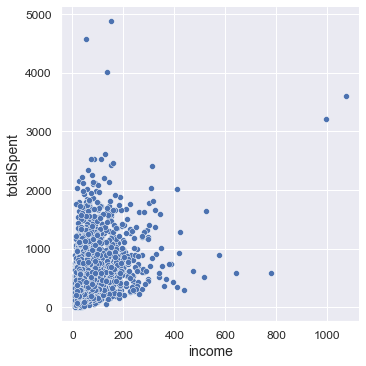

In [11]:
# Seaborn scatter plot with regression line
sns.relplot(x='income', y='totalSpent', data=customers_df)

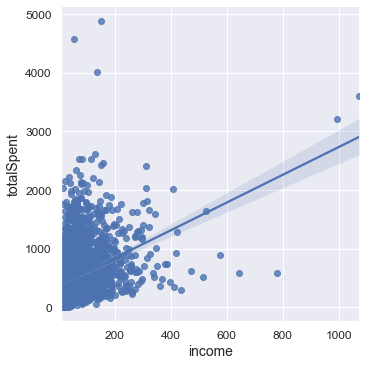

In [12]:
sns.lmplot(x='income', y='totalSpent', data=customers_df)

### What do you notice about the data points?

In [8]:
# Creating Categorical List = Contains categorical variables...

for x in ['region','townsize','gender','agecat','edcat','jobcat','union','employ','empcat','retire',
          'inccat','default','jobsat','marital','spousedcat','homeown','hometype','address','addresscat','cars','carown',
          'cartype','carcatvalue','carbought','carbuy','commute','commutecat','commutecar',
          'commutemotorcycle','commutecarpool','commutebus','commuterail','commutepublic','commutebike','commutewalk',
         'commutenonmotor','telecommute','reason','polview','polparty','polcontrib','vote','card','cardtype','cardbenefit',
         'cardfee','cardtenure','cardtenurecat','card2','card2type','card2benefit','card2fee','card2tenure','card2tenurecat',
         'active','bfast','churn','tollfree','equip','callcard','wireless','multline','voice','pager','internet','callid',
         'callwait','forward','confer','ebill','owntv','ownvcr','owndvd','owncd','ownpda','ownpc','ownipod','owngame','ownfax',
        'news','response_01','response_02','response_03']:
    customers_df[x]=customers_df[x].astype('object')


In [7]:
type(customers_df['townsize'])

pandas.core.series.Series

In [20]:
customers_df.describe()

,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,totalSpent
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,4999.000000,5000.000000,4999.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,4998.000000,5000.000000,5000.000000,5000.000000,4997.000000,4997.000000,5000.000000,2378.000000,5000.000000,2378.000000,5000.000000,1704.000000,5000.000000,1704.000000,5000.000000,3581.000000,4998.000000,3578.000000,5000.000000,1344.000000,5000.000000,1344.000000,5000.000000,5000.00000
mean,47.025600,14.543000,54.759600,3.699909,9.954160,1.857326,-0.130454,3.654460,0.696915,6.112800,2.204000,3.067400,0.500400,0.392400,0.110400,0.055600,0.114600,0.046600,1.847400,23.232580,25.345538,38.204800,13.471450,2.288779,708.871753,5.611298,13.264450,3.243230,577.832510,6.584783,12.991310,3.600238,470.176400,6.747296,15.443850,2.909733,720.478391,6.426309,10.701190,3.605001,421.984610,6.808132,19.645000,498.07863
std,17.770338,3.281083,55.377511,0.747072,6.399783,3.415732,1.273058,5.395172,1.128578,7.743518,1.393977,3.414497,0.860783,0.796084,0.494227,0.325776,0.568798,0.469545,3.074801,21.231637,5.879149,22.661888,12.773381,0.775178,979.291072,1.649308,16.310018,0.404659,949.151586,1.222040,19.212943,0.283385,912.220624,1.199234,15.007569,0.564859,922.225527,1.172050,19.799837,0.390102,1001.003287,1.283967,5.165609,351.52927
min,18.000000,6.000000,9.000000,2.197225,0.000000,0.000000,-6.597334,0.000000,-4.092107,-1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.000000,8.000000,0.000000,0.900000,-0.105361,0.900000,-0.105361,0.000000,2.079442,0.000000,2.169054,0.000000,2.833213,0.000000,2.489065,0.000000,1.178655,0.000000,1.558145,0.000000,2.541602,0.000000,2.541602,0.000000,8.11000
25%,31.000000,12.000000,24.000000,3.178054,5.100000,0.385520,-0.952685,0.980301,-0.018987,-1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.200000,21.000000,18.000000,5.700000,1.740466,104.600000,4.650144,0.000000,2.970414,0.000000,5.912218,0.000000,3.412797,0.000000,6.171570,0.000000,2.545531,0.000000,5.857933,0.000000,3.330417,0.000000,6.158091,17.000000,276.28250
50%,47.000000,14.000000,38.000000,3.637586,8.800000,0.926437,-0.076106,2.098540,0.741537,-1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,25.000000,38.000000,9.550000,2.256541,350.000000,5.857933,0.000000,3.228826,0.000000,6.858013,0.000000,3.598681,0.000000,7.050556,13.750000,2.904165,425.000000,6.639876,0.000000,3.597997,0.000000,7.147185,20.000000,414.25000
75%,62.000000,17.000000,67.000000,4.204693,13.600000,2.063820,0.724665,4.314780,1.462053,14.000000,3.000000,5.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,31.100000,29.000000,59.000000,16.550000,2.806386,913.850000,6.817666,24.500000,3.518980,885.450000,7.459900,30.800000,3.790138,510.162500,7.649835,22.750000,3.295837,1080.000000,7.218910,20.962500,3.865193,89.962500,7.755376,23.000000,615.56250
max,79.000000,23.000000,1073.000000,6.978214,43.100000,109.072596,4.692014,141.459150,4.952011,24.000000,9.000000,21.000000,6.000000,7.000000,5.000000,6.000000,7.000000,8.000000,16.000000,99.600000,48.000000,72.000000,179.850000,5.192123,13046.500000,9.476275,173.000000,4.622519,6923.450000,8.842669,106.300000,4.666265,6525.300000,8.783442,188.500000,5.239098,13705.000000,9.525516,186.250000,5.227090,12858.650000,9.461772,36.000000,4881.05000


### 3.2 Check column types: categorical, numerical

In [9]:
# Find numerical variable in Data frame.
# This will return a list
numerical_var = [key for key in dict(customers_df.dtypes) if dict(customers_df.dtypes)[key] in ['float64', 'int64', 'float32', 'int32']]

# Find Categorical variable in Data frame
categorical_var = [key for key in dict(customers_df.dtypes) if dict(customers_df.dtypes)[key] in ['object']]

# Print the data frame
print( numerical_var)
print(categorical_var)

['age', 'ed', 'income', 'lninc', 'debtinc', 'creddebt', 'lncreddebt', 'othdebt', 'lnothdebt', 'spoused', 'reside', 'pets', 'pets_cats', 'pets_dogs', 'pets_birds', 'pets_reptiles', 'pets_small', 'pets_saltfish', 'pets_freshfish', 'carvalue', 'commutetime', 'tenure', 'longmon', 'lnlongmon', 'longten', 'lnlongten', 'tollmon', 'lntollmon', 'tollten', 'lntollten', 'equipmon', 'lnequipmon', 'equipten', 'lnequipten', 'cardmon', 'lncardmon', 'cardten', 'lncardten', 'wiremon', 'lnwiremon', 'wireten', 'lnwireten', 'hourstv', 'totalSpent']
['region', 'townsize', 'gender', 'agecat', 'edcat', 'jobcat', 'union', 'employ', 'empcat', 'retire', 'inccat', 'default', 'jobsat', 'marital', 'spousedcat', 'homeown', 'hometype', 'address', 'addresscat', 'cars', 'carown', 'cartype', 'carcatvalue', 'carbought', 'carbuy', 'commute', 'commutecat', 'commutecar', 'commutemotorcycle', 'commutecarpool', 'commutebus', 'commuterail', 'commutepublic', 'commutebike', 'commutewalk', 'commutenonmotor', 'telecommute', 'reas

In [10]:
# Convert a list in to dataframe 
# Information about numeric variables in dataframe

customersNum_df = customers_df[numerical_var]
customersNum_df.head(5)


,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,totalSpent
0,20,15,31,3.433987,11.1,1.200909,0.183079,2.240091,0.806516,-1,3,0,0,0,0,0,0,0,0,14.3,22.0,5,6.50,1.871802,34.40,3.538057,29.0,3.367296,161.05,5.081715,29.50,3.384390,126.1,4.837075,14.25,2.656757,60.0,4.094345,0.00,NaN,0.00,NaN,13,149.46
1,22,17,15,2.708050,18.6,1.222020,0.200505,1.567980,0.449788,-1,2,6,0,0,0,0,0,0,6,6.8,29.0,39,8.90,2.186051,330.60,5.800909,0.0,NaN,0.00,NaN,54.85,4.004602,1975.0,7.588324,16.00,2.772589,610.0,6.413459,45.65,3.821004,1683.55,7.428660,18,77.54
2,67,14,35,3.555348,9.9,0.928620,-0.074056,2.536380,0.930738,13,3,3,2,1,0,0,0,0,0,18.8,24.0,65,28.40,3.346389,1858.35,7.527444,0.0,NaN,0.00,NaN,0.00,NaN,0.0,NaN,23.00,3.135494,1410.0,7.251345,0.00,NaN,0.00,NaN,21,359.97
3,23,16,20,2.995732,5.7,0.022800,-3.780995,1.117200,0.110826,18,5,0,0,0,0,0,0,0,0,8.7,38.0,36,6.00,1.791759,199.45,5.295564,0.0,NaN,0.00,NaN,0.00,NaN,0.0,NaN,21.00,3.044522,685.0,6.529419,0.00,NaN,0.00,NaN,26,359.41
4,26,16,23,3.135494,1.7,0.214659,-1.538705,0.176341,-1.735336,13,4,0,0,0,0,0,0,0,0,10.6,32.0,21,3.05,1.115142,74.10,4.305416,16.5,2.803360,387.70,5.960232,0.00,NaN,0.0,NaN,17.25,2.847812,360.0,5.886104,19.05,2.947067,410.80,6.018106,27,507.83


In [11]:
# Convert a list in to dataframe 
# Information about categorical variables in dataframe
customersCat_df = customers_df[categorical_var]
customersCat_df.head(5)

,region,townsize,gender,agecat,edcat,jobcat,union,employ,empcat,retire,inccat,default,jobsat,marital,spousedcat,homeown,hometype,address,addresscat,cars,carown,cartype,carcatvalue,carbought,carbuy,commute,commutecat,commutecar,commutemotorcycle,commutecarpool,commutebus,commuterail,commutepublic,commutebike,commutewalk,commutenonmotor,telecommute,reason,polview,polparty,polcontrib,vote,card,cardtype,cardbenefit,cardfee,cardtenure,cardtenurecat,card2,card2type,card2benefit,card2fee,card2tenure,card2tenurecat,active,bfast,churn,tollfree,equip,callcard,wireless,multline,voice,pager,internet,callid,callwait,forward,confer,ebill,owntv,ownvcr,owndvd,owncd,ownpda,ownpc,ownipod,owngame,ownfax,news,response_01,response_02,response_03
0,1,2.0,1,2,3,1,1,0,1,0,2,1,1,0,-1,0,2,0,1,2,1,0,1,0,0,8,4,0,1,1,0,0,0,0,1,0,0,9,6,1,0,1,3,1,1,0,2,2,5,3,1,0,3,2,0,3,1,1,1,1,0,1,1,1,0,0,1,1,1,0,1,1,1,0,0,0,1,1,0,0,0,1,0
1,5,5.0,0,2,4,2,0,0,1,0,1,1,1,0,-1,1,3,2,1,2,1,1,1,0,0,1,1,1,0,0,1,0,0,1,0,1,1,9,4,1,0,0,2,4,1,0,4,2,4,1,3,0,4,2,1,1,0,0,1,1,1,1,1,1,4,1,0,1,0,1,1,1,1,1,1,1,1,1,1,1,0,0,0
2,3,4.0,1,6,2,2,0,16,5,0,2,0,4,1,2,1,1,30,5,3,1,1,1,0,1,4,3,1,0,1,1,1,0,0,0,0,0,2,5,1,0,0,2,1,4,0,35,5,4,1,3,0,25,5,0,3,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,1,0,0,0
3,4,3.0,0,2,3,2,0,0,1,0,1,1,2,1,4,1,3,3,2,3,1,1,1,0,1,1,1,1,0,0,0,0,0,0,0,0,0,9,3,0,0,0,2,1,4,0,5,2,3,2,4,0,5,2,1,1,0,0,0,1,0,1,0,0,2,0,0,0,0,1,1,1,1,1,0,1,1,1,0,1,1,0,0
4,2,2.0,0,3,3,2,0,1,1,0,1,0,1,1,2,0,2,3,2,1,0,1,1,0,1,6,3,0,0,0,0,0,1,0,1,0,0,9,4,0,0,0,4,2,1,0,8,3,1,3,2,0,9,3,1,3,0,1,0,1,1,0,1,0,3,1,1,1,1,0,1,1,1,1,0,1,0,1,0,0,0,1,0


### Creating Data Summary Report

In [12]:
# Generate a summary report for numerical variables (sum, mean, median, std, var, min, max, etc)
def var_summary(x):
    return pd.Series([x.count(), x.isnull().sum(), x.sum(), x.mean(), x.median(),  x.std(), x.var(), x.min(), x.dropna().quantile(0.01), x.dropna().quantile(0.05),x.dropna().quantile(0.10),x.dropna().quantile(0.25),x.dropna().quantile(0.50),x.dropna().quantile(0.75), x.dropna().quantile(0.90),x.dropna().quantile(0.95), x.dropna().quantile(0.99),x.max()], 
                  index=['N', 'NMISS', 'SUM', 'MEAN','MEDIAN', 'STD', 'VAR', 'MIN', 'P1' , 'P5' ,'P10' ,'P25' ,'P50' ,'P75' ,'P90' ,'P95' ,'P99' ,'MAX'])

num_summary=customersNum_df.apply(lambda x: var_summary(x)).T

In [25]:
num_summary.head(5)

,N,NMISS,SUM,MEAN,MEDIAN,STD,VAR,MIN,P1,P5,P10,P25,P50,P75,P90,P95,P99,MAX
age,5000.0,0.0,235128.000000,47.025600,47.000000,17.770338,315.784902,18.000000,18.000000,20.000000,23.000000,31.000000,47.000000,62.000000,72.000000,76.000000,79.000000,79.000000
ed,5000.0,0.0,72715.000000,14.543000,14.000000,3.281083,10.765504,6.000000,8.000000,9.000000,10.000000,12.000000,14.000000,17.000000,19.000000,20.000000,21.000000,23.000000
income,5000.0,0.0,273798.000000,54.759600,38.000000,55.377511,3066.668742,9.000000,9.000000,13.000000,16.000000,24.000000,38.000000,67.000000,109.100000,147.000000,272.010000,1073.000000
lninc,5000.0,0.0,18499.546992,3.699909,3.637586,0.747072,0.558116,2.197225,2.197225,2.564949,2.772589,3.178054,3.637586,4.204693,4.692261,4.990433,5.605839,6.978214
debtinc,5000.0,0.0,49770.800000,9.954160,8.800000,6.399783,40.957226,0.000000,0.700000,1.900000,2.800000,5.100000,8.800000,13.600000,18.600000,22.200000,29.200000,43.100000


In [13]:
# Generate a summary report for categorical variables
def cat_summary(x):
    return pd.Series([x.count(),x.isnull().sum(),x.value_counts(),x.unique()],
                    index=['N','NMISS','ColumnNames','UniqueValues'])
cat_summary=customersCat_df.apply(lambda x:cat_summary(x)).T

In [14]:
cat_summary.head(3)

,N,NMISS,ColumnNames,UniqueValues
region,5000,0,5 1027 1 1009 3 1003 2 995 4 ...,"[1, 5, 3, 4, 2]"
townsize,4998,2,1.0 1436 2.0 1048 3.0 907 4.0 85...,"[2.0, 5.0, 4.0, 3.0, 1.0, nan]"
gender,5000,0,"1 2518 0 2482 Name: gender, dtype: int64","[1, 0]"


### 3.3 Handle Outliers
#### There are some outliers which need to be rectified so that they will not have an impact on our model

In [15]:
# Handling Outliers for numerical data
def outlier_capping(x):
    
    x = x.clip(lower = x.quantile(0.01), upper=x.quantile(0.99))

    return x

customersNum_df = customersNum_df.apply(lambda x: outlier_capping(x))


### 3.4 Handle Missing Values

#### As we can see in the above summary report some data is missing in the numerical data set and some are missing in categorical.
#### We will treat numerical missing data with mean() and categorical data with mode()

In [16]:
# Handling missing numerical data - by Function (Make the function to treat all data in one shot)
def Missing_imputation(x):
    x = x.fillna(x.mean())
    return x

customersNum_df = customersNum_df.apply(lambda x: Missing_imputation(x))

In [17]:
# Handling missing categorical data - by Function (Make the function to treat all data in one shot)
def Missing_imputation(x):
    x = x.fillna(x.mode())
    return x

customersCat_df = customersCat_df.apply(lambda x: Missing_imputation(x))

In [18]:
# Getting rid of that null values from column 'townsize'
for column in ['townsize']:
    customersCat_df["townsize"].fillna(customersCat_df["townsize"].mode()[0], inplace=True)

#### Again check missing values to make sure they have been treated or not

In [19]:
# Find the total number of missing values in the numerical data i.e custdata_df_num
print ("\nMissing values in numerical data :  ", customersNum_df.isnull().sum().values.sum())
print ("\nMissing values in categorical data :  ", customersCat_df.isnull().sum().values.sum())


Missing values in numerical data :   0

Missing values in categorical data :   0


### 3.5 Dummy creation for categorical data

In [20]:
# We need to create a function for dummy creation
# https://pandas.pydata.org/docs/reference/api/pandas.get_dummies.html

def create_dummies(df, colname):
    col_dummies = pd.get_dummies(df[colname], prefix = colname)
    col_dummies.drop(col_dummies.columns[0], axis = 1, inplace = True)
    df = pd.concat([df, col_dummies], axis = 1)
    df.drop(colname, axis = 1, inplace = True)
    return df


In [21]:
# Get categorical variables as a list
# cat_varlist
customersCat_df=customers_df.select_dtypes(include=['object'])
categorical_var=list(customersCat_df.columns)

In [22]:
# For customer_features in categorical features
for cat_feature in categorical_var:
    customersCat_df[cat_feature]=customersCat_df[cat_feature].astype('category')
    customersCat_df=create_dummies(customersCat_df,cat_feature)

In [23]:
# Display some of the categorical features and their values
customersCat_df.sample(5)

,region_2,region_3,region_4,region_5,townsize_2.0,townsize_3.0,townsize_4.0,townsize_5.0,gender_1,agecat_3,agecat_4,agecat_5,agecat_6,edcat_2,edcat_3,edcat_4,edcat_5,jobcat_2,jobcat_3,jobcat_4,jobcat_5,jobcat_6,union_1,employ_1,employ_2,employ_3,employ_4,employ_5,employ_6,employ_7,employ_8,employ_9,employ_10,employ_11,employ_12,employ_13,employ_14,employ_15,employ_16,employ_17,employ_18,employ_19,employ_20,employ_21,employ_22,employ_23,employ_24,employ_25,employ_26,employ_27,employ_28,employ_29,employ_30,employ_31,employ_32,employ_33,employ_34,employ_35,employ_36,employ_37,employ_38,employ_39,employ_40,employ_41,employ_42,employ_43,employ_44,employ_45,employ_46,employ_47,employ_48,employ_49,employ_51,employ_52,empcat_2,empcat_3,empcat_4,empcat_5,retire_1,inccat_2,inccat_3,inccat_4,inccat_5,default_1,jobsat_2,jobsat_3,jobsat_4,jobsat_5,marital_1,spousedcat_1,spousedcat_2,spousedcat_3,spousedcat_4,spousedcat_5,homeown_1,hometype_2,hometype_3,hometype_4,address_1,address_2,address_3,address_4,address_5,address_6,address_7,address_8,address_9,address_10,address_11,address_12,address_13,address_14,address_15,address_16,address_17,address_18,address_19,address_20,address_21,address_22,address_23,address_24,address_25,address_26,address_27,address_28,address_29,address_30,address_31,address_32,address_33,address_34,address_35,address_36,address_37,address_38,address_39,address_40,address_41,address_42,address_43,address_44,address_45,address_46,address_47,address_48,address_49,address_50,address_51,address_52,address_53,address_54,address_55,address_57,addresscat_2,addresscat_3,addresscat_4,addresscat_5,cars_1,cars_2,cars_3,cars_4,cars_5,cars_6,cars_7,cars_8,carown_0,carown_1,cartype_0,cartype_1,carcatvalue_1,carcatvalue_2,carcatvalue_3,carbought_0,carbought_1,carbuy_1,commute_2,commute_3,commute_4,commute_5,commute_6,commute_7,commute_8,commute_9,commute_10,commutecat_2,commutecat_3,commutecat_4,commutecat_5,commutecar_1,commutemotorcycle_1,commutecarpool_1,commutebus_1,commuterail_1,commutepublic_1,commutebike_1,commutewalk_1,commutenonmotor_1,telecommute_1,reason_2,reason_3,reason_4,reason_9,polview_2,polview_3,polview_4,polview_5,polview_6,polview_7,polparty_1,polcontrib_1,vote_1,card_2,card_3,card_4,card_5,cardtype_2,cardtype_3,cardtype_4,cardbenefit_2,cardbenefit_3,cardbenefit_4,cardfee_1,cardtenure_1,cardtenure_2,cardtenure_3,cardtenure_4,cardtenure_5,cardtenure_6,cardtenure_7,cardtenure_8,cardtenure_9,cardtenure_10,cardtenure_11,cardtenure_12,cardtenure_13,cardtenure_14,cardtenure_15,cardtenure_16,cardtenure_17,cardtenure_18,cardtenure_19,cardtenure_20,cardtenure_21,cardtenure_22,cardtenure_23,cardtenure_24,cardtenure_25,cardtenure_26,cardtenure_27,cardtenure_28,cardtenure_29,cardtenure_30,cardtenure_31,cardtenure_32,cardtenure_33,cardtenure_34,cardtenure_35,cardtenure_36,cardtenure_37,cardtenure_38,cardtenure_39,cardtenure_40,cardtenurecat_2,cardtenurecat_3,cardtenurecat_4,cardtenurecat_5,card2_2,card2_3,card2_4,card2_5,card2type_2,card2type_3,card2type_4,card2benefit_2,card2benefit_3,card2benefit_4,card2fee_1,card2tenure_1,card2tenure_2,card2tenure_3,card2tenure_4,card2tenure_5,card2tenure_6,card2tenure_7,card2tenure_8,card2tenure_9,card2tenure_10,card2tenure_11,card2tenure_12,card2tenure_13,card2tenure_14,card2tenure_15,card2tenure_16,card2tenure_17,card2tenure_18,card2tenure_19,card2tenure_20,card2tenure_21,card2tenure_22,card2tenure_23,card2tenure_24,card2tenure_25,card2tenure_26,card2tenure_27,card2tenure_28,card2tenure_29,card2tenure_30,card2tenurecat_2,card2tenurecat_3,card2tenurecat_4,card2tenurecat_5,active_1,bfast_2,bfast_3,churn_1,tollfree_1,equip_1,callcard_1,wireless_1,multline_1,voice_1,pager_1,internet_1,internet_2,internet_3,internet_4,callid_1,callwait_1,forward_1,confer_1,ebill_1,owntv_1,ownvcr_1,owndvd_1,owncd_1,ownpda_1,ownpc_1,ownipod_1,owngame_1,ownfax_1,news_1,response_01_1,response_02_1,response_03_1
2048,0,0,0,1,0,0,0,1,1,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

### 3.6 Merge Numerical and Categorical data

***Now we have clean data for numerical and categorical data frames, so we can merge both data sets***

In [24]:
customersNew_df = pd.concat([customersNum_df, customersCat_df], axis=1)

In [25]:
# Display the combined data frame
customersNew_df.head(5)

,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,totalSpent,region_2,region_3,region_4,region_5,townsize_2.0,townsize_3.0,townsize_4.0,townsize_5.0,gender_1,agecat_3,agecat_4,agecat_5,agecat_6,edcat_2,edcat_3,edcat_4,edcat_5,jobcat_2,jobcat_3,jobcat_4,jobcat_5,jobcat_6,union_1,employ_1,employ_2,employ_3,employ_4,employ_5,employ_6,employ_7,employ_8,employ_9,employ_10,employ_11,employ_12,employ_13,employ_14,employ_15,employ_16,employ_17,employ_18,employ_19,employ_20,employ_21,employ_22,employ_23,employ_24,employ_25,employ_26,employ_27,employ_28,employ_29,employ_30,employ_31,employ_32,employ_33,employ_34,employ_35,employ_36,employ_37,employ_38,employ_39,employ_40,employ_41,employ_42,employ_43,employ_44,employ_45,employ_46,employ_47,employ_48,employ_49,employ_51,employ_52,empcat_2,empcat_3,empcat_4,empcat_5,retire_1,inccat_2,inccat_3,inccat_4,inccat_5,default_1,jobsat_2,jobsat_3,jobsat_4,jobsat_5,marital_1,spousedcat_1,spousedcat_2,spousedcat_3,spousedcat_4,spousedcat_5,homeown_1,hometype_2,hometype_3,hometype_4,address_1,address_2,address_3,address_4,address_5,address_6,address_7,address_8,address_9,address_10,address_11,address_12,address_13,address_14,address_15,address_16,address_17,address_18,address_19,address_20,address_21,address_22,address_23,address_24,address_25,address_26,address_27,address_28,address_29,address_30,address_31,address_32,address_33,address_34,address_35,address_36,address_37,address_38,address_39,address_40,address_41,address_42,address_43,address_44,address_45,address_46,address_47,address_48,address_49,address_50,address_51,address_52,address_53,address_54,address_55,address_57,addresscat_2,addresscat_3,addresscat_4,addresscat_5,cars_1,cars_2,cars_3,cars_4,cars_5,cars_6,cars_7,cars_8,carown_0,carown_1,cartype_0,cartype_1,carcatvalue_1,carcatvalue_2,carcatvalue_3,carbought_0,carbought_1,carbuy_1,commute_2,commute_3,commute_4,commute_5,commute_6,commute_7,commute_8,commute_9,commute_10,commutecat_2,commutecat_3,commutecat_4,commutecat_5,commutecar_1,commutemotorcycle_1,commutecarpool_1,commutebus_1,commuterail_1,commutepublic_1,commutebike_1,commutewalk_1,commutenonmotor_1,telecommute_1,reason_2,reason_3,reason_4,reason_9,polview_2,polview_3,polview_4,polview_5,polview_6,polview_7,polparty_1,polcontrib_1,vote_1,card_2,card_3,card_4,card_5,cardtype_2,cardtype_3,cardtype_4,cardbenefit_2,cardbenefit_3,cardbenefit_4,cardfee_1,cardtenure_1,cardtenure_2,cardtenure_3,cardtenure_4,cardtenure_5,cardtenure_6,cardtenure_7,cardtenure_8,cardtenure_9,cardtenure_10,cardtenure_11,cardtenure_12,cardtenure_13,cardtenure_14,cardtenure_15,cardtenure_16,cardtenure_17,cardtenure_18,cardtenure_19,cardtenure_20,cardtenure_21,cardtenure_22,cardtenure_23,cardtenure_24,cardtenure_25,cardtenure_26,cardtenure_27,cardtenure_28,cardtenure_29,cardtenure_30,cardtenure_31,cardtenure_32,cardtenure_33,cardtenure_34,cardtenure_35,cardtenure_36,cardtenure_37,cardtenure_38,cardtenure_39,cardtenure_40,cardtenurecat_2,cardtenurecat_3,cardtenurecat_4,cardtenurecat_5,card2_2,card2_3,card2_4,card2_5,card2type_2,card2type_3,card2type_4,card2benefit_2,card2benefit_3,card2benefit_4,card2fee_1,card2tenure_1,card2tenure_2,card2tenure_3,card2tenure_4,card2tenure_5,card2tenure_6,card2tenure_7,card2tenure_8,card2tenure_9,card2tenure_10,card2tenure_11,card2tenure_12,card2tenure_13,card2tenure_14,card2tenure_15,card2tenure_16,card2tenure_17,card2tenure_18,card2tenure_19,card2tenure_20,card2tenure_21,card2tenure_22,card2tenure_23,card2tenure_24,card2tenure_25,card2tenure_26,card2tenure_27,card2tenure_28,card2tenure_29,card2tenure_30,card2tenurecat_2,card2tenurecat_3,card2tenurecat_4,card2tenurecat_5,active_1,bfast_2,bfas

In [41]:
customersNew_df.shape

(5000, 389)

## 4 Exploratory Data Analysis

<AxesSubplot:xlabel='totalSpent', ylabel='Density'>

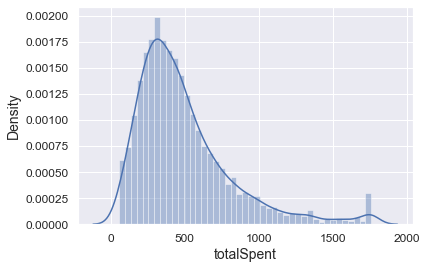

In [26]:
# Examine the distribution of totalspend
sns.distplot(customersNew_df.totalSpent)

### Is the distribution skewed? Which direction? Try taking the log and seeing the result

In [27]:
"""
skewed line: not intersect & not parallel

distribution is skewed, non-linear (...)
"""

'\nskewed line: not intersect & not parallel\n\ndistribution is skewed, non-linear (...)\n'

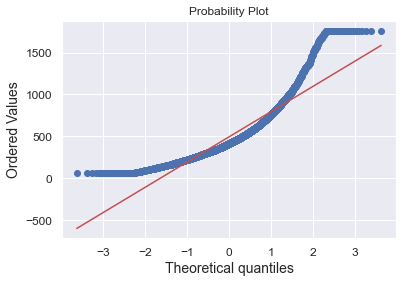

In [28]:
from scipy import stats
import pylab

stats.probplot(customersNew_df.totalSpent, dist="norm", plot=pylab )
pylab.show()

***As we can see above graph our data is not distributed normally perfectly, so we will use boxcox techniue to make it perfect normal***

In [29]:
from scipy import stats

# transform training data & save lambda value
customersNew_df['bc_totalSpent'],fitted_lambda = stats.boxcox(customersNew_df['totalSpent'])

'\n    Boxcox transforms our data so that it closely resembles a normal distribution. \n    In many statistical techniques, we assume that the errors are normally distributed. \n    This assumption allows us to construct confidence intervals and conduct hypothesis tests\n'

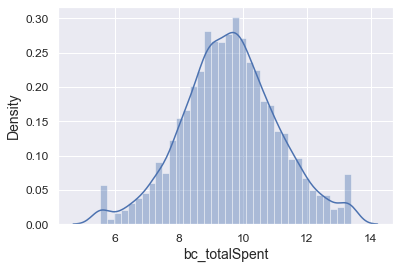

In [30]:
sns.distplot(customersNew_df.bc_totalSpent)
"""
    Boxcox transforms our data so that it closely resembles a normal distribution. 
    In many statistical techniques, we assume that the errors are normally distributed. 
    This assumption allows us to construct confidence intervals and conduct hypothesis tests
"""

In [48]:
customersNew_df.head(3)

,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,totalSpent,region_2,region_3,region_4,region_5,townsize_2.0,townsize_3.0,townsize_4.0,townsize_5.0,gender_1,agecat_3,agecat_4,agecat_5,agecat_6,edcat_2,edcat_3,edcat_4,edcat_5,jobcat_2,jobcat_3,jobcat_4,jobcat_5,jobcat_6,union_1,employ_1,employ_2,employ_3,employ_4,employ_5,employ_6,employ_7,employ_8,employ_9,employ_10,employ_11,employ_12,employ_13,employ_14,employ_15,employ_16,employ_17,employ_18,employ_19,employ_20,employ_21,employ_22,employ_23,employ_24,employ_25,employ_26,employ_27,employ_28,employ_29,employ_30,employ_31,employ_32,employ_33,employ_34,employ_35,employ_36,employ_37,employ_38,employ_39,employ_40,employ_41,employ_42,employ_43,employ_44,employ_45,employ_46,employ_47,employ_48,employ_49,employ_51,employ_52,empcat_2,empcat_3,empcat_4,empcat_5,retire_1,inccat_2,inccat_3,inccat_4,inccat_5,default_1,jobsat_2,jobsat_3,jobsat_4,jobsat_5,marital_1,spousedcat_1,spousedcat_2,spousedcat_3,spousedcat_4,spousedcat_5,homeown_1,hometype_2,hometype_3,hometype_4,address_1,address_2,address_3,address_4,address_5,address_6,address_7,address_8,address_9,address_10,address_11,address_12,address_13,address_14,address_15,address_16,address_17,address_18,address_19,address_20,address_21,address_22,address_23,address_24,address_25,address_26,address_27,address_28,address_29,address_30,address_31,address_32,address_33,address_34,address_35,address_36,address_37,address_38,address_39,address_40,address_41,address_42,address_43,address_44,address_45,address_46,address_47,address_48,address_49,address_50,address_51,address_52,address_53,address_54,address_55,address_57,addresscat_2,addresscat_3,addresscat_4,addresscat_5,cars_1,cars_2,cars_3,cars_4,cars_5,cars_6,cars_7,cars_8,carown_0,carown_1,cartype_0,cartype_1,carcatvalue_1,carcatvalue_2,carcatvalue_3,carbought_0,carbought_1,carbuy_1,commute_2,commute_3,commute_4,commute_5,commute_6,commute_7,commute_8,commute_9,commute_10,commutecat_2,commutecat_3,commutecat_4,commutecat_5,commutecar_1,commutemotorcycle_1,commutecarpool_1,commutebus_1,commuterail_1,commutepublic_1,commutebike_1,commutewalk_1,commutenonmotor_1,telecommute_1,reason_2,reason_3,reason_4,reason_9,polview_2,polview_3,polview_4,polview_5,polview_6,polview_7,polparty_1,polcontrib_1,vote_1,card_2,card_3,card_4,card_5,cardtype_2,cardtype_3,cardtype_4,cardbenefit_2,cardbenefit_3,cardbenefit_4,cardfee_1,cardtenure_1,cardtenure_2,cardtenure_3,cardtenure_4,cardtenure_5,cardtenure_6,cardtenure_7,cardtenure_8,cardtenure_9,cardtenure_10,cardtenure_11,cardtenure_12,cardtenure_13,cardtenure_14,cardtenure_15,cardtenure_16,cardtenure_17,cardtenure_18,cardtenure_19,cardtenure_20,cardtenure_21,cardtenure_22,cardtenure_23,cardtenure_24,cardtenure_25,cardtenure_26,cardtenure_27,cardtenure_28,cardtenure_29,cardtenure_30,cardtenure_31,cardtenure_32,cardtenure_33,cardtenure_34,cardtenure_35,cardtenure_36,cardtenure_37,cardtenure_38,cardtenure_39,cardtenure_40,cardtenurecat_2,cardtenurecat_3,cardtenurecat_4,cardtenurecat_5,card2_2,card2_3,card2_4,card2_5,card2type_2,card2type_3,card2type_4,card2benefit_2,card2benefit_3,card2benefit_4,card2fee_1,card2tenure_1,card2tenure_2,card2tenure_3,card2tenure_4,card2tenure_5,card2tenure_6,card2tenure_7,card2tenure_8,card2tenure_9,card2tenure_10,card2tenure_11,card2tenure_12,card2tenure_13,card2tenure_14,card2tenure_15,card2tenure_16,card2tenure_17,card2tenure_18,card2tenure_19,card2tenure_20,card2tenure_21,card2tenure_22,card2tenure_23,card2tenure_24,card2tenure_25,card2tenure_26,card2tenure_27,card2tenure_28,card2tenure_29,card2tenure_30,card2tenurecat_2,card2tenurecat_3,card2tenurecat_4,card2tenurecat_5,active_1,bfast_2,bfas

### Plot it again to see the result

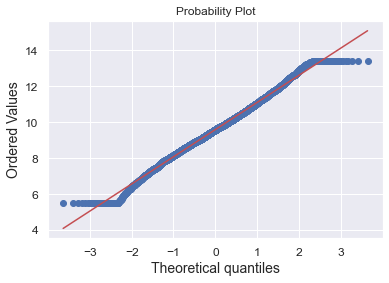

In [31]:
stats.probplot(customersNew_df.bc_totalSpent, dist="norm", plot=pylab )
pylab.show()

In [32]:
# line is now not skewed

In [89]:
# Do a correlation plot across all x variables

import matplotlib.pyplot as plt

corr = customersNew_df.corr()
corr.style.background_gradient(cmap='coolwarm')


## 5. Modelling 

#### Divide data into train and test data 

In [36]:
# Splitting the data - use 80% of the data for training

feature_columns=customersNew_df.columns.difference(['bc_totalSpent'])

# dataframe.columns.difference() gives you complement of the values that you provide as argument. 
# It can be used to create a new dataframe from an existing dataframe with exclusion of some columns.
# we separatebc-total-spent bcs it is the output var, the rest is input var

In [37]:
customersNew_df.columns

Index(['age', 'ed', 'income', 'lninc', 'debtinc', 'creddebt', 'lncreddebt',
       'othdebt', 'lnothdebt', 'spoused',
       ...
       'ownpda_1', 'ownpc_1', 'ownipod_1', 'owngame_1', 'ownfax_1', 'news_1',
       'response_01_1', 'response_02_1', 'response_03_1', 'bc_totalSpent'],
      dtype='object', length=389)

In [38]:
from sklearn.model_selection import train_test_split

train_x,test_x,train_y,test_y=train_test_split(customersNew_df[feature_columns],
                                              customersNew_df['bc_totalSpent'],
                                              test_size=0.2,
                                              random_state=12)

In [39]:
print (len(train_x))
print (len(test_x))
print (len(train_y))
print (len(test_y))

4000
1000
4000
1000


In [40]:
customersNew_df.head(3)

,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,region_2,region_3,region_4,region_5,townsize_2.0,townsize_3.0,townsize_4.0,townsize_5.0,gender_1,agecat_3,agecat_4,agecat_5,agecat_6,edcat_2,edcat_3,edcat_4,edcat_5,jobcat_2,jobcat_3,jobcat_4,jobcat_5,jobcat_6,union_1,employ_1,employ_2,employ_3,employ_4,employ_5,employ_6,employ_7,employ_8,employ_9,employ_10,employ_11,employ_12,employ_13,employ_14,employ_15,employ_16,employ_17,employ_18,employ_19,employ_20,employ_21,employ_22,employ_23,employ_24,employ_25,employ_26,employ_27,employ_28,employ_29,employ_30,employ_31,employ_32,employ_33,employ_34,employ_35,employ_36,employ_37,employ_38,employ_39,employ_40,employ_41,employ_42,employ_43,employ_44,employ_45,employ_46,employ_47,employ_48,employ_49,employ_51,employ_52,empcat_2,empcat_3,empcat_4,empcat_5,retire_1,inccat_2,inccat_3,inccat_4,inccat_5,default_1,jobsat_2,jobsat_3,jobsat_4,jobsat_5,marital_1,spousedcat_1,spousedcat_2,spousedcat_3,spousedcat_4,spousedcat_5,homeown_1,hometype_2,hometype_3,hometype_4,address_1,address_2,address_3,address_4,address_5,address_6,address_7,address_8,address_9,address_10,address_11,address_12,address_13,address_14,address_15,address_16,address_17,address_18,address_19,address_20,address_21,address_22,address_23,address_24,address_25,address_26,address_27,address_28,address_29,address_30,address_31,address_32,address_33,address_34,address_35,address_36,address_37,address_38,address_39,address_40,address_41,address_42,address_43,address_44,address_45,address_46,address_47,address_48,address_49,address_50,address_51,address_52,address_53,address_54,address_55,address_57,addresscat_2,addresscat_3,addresscat_4,addresscat_5,cars_1,cars_2,cars_3,cars_4,cars_5,cars_6,cars_7,cars_8,carown_0,carown_1,cartype_0,cartype_1,carcatvalue_1,carcatvalue_2,carcatvalue_3,carbought_0,carbought_1,carbuy_1,commute_2,commute_3,commute_4,commute_5,commute_6,commute_7,commute_8,commute_9,commute_10,commutecat_2,commutecat_3,commutecat_4,commutecat_5,commutecar_1,commutemotorcycle_1,commutecarpool_1,commutebus_1,commuterail_1,commutepublic_1,commutebike_1,commutewalk_1,commutenonmotor_1,telecommute_1,reason_2,reason_3,reason_4,reason_9,polview_2,polview_3,polview_4,polview_5,polview_6,polview_7,polparty_1,polcontrib_1,vote_1,card_2,card_3,card_4,card_5,cardtype_2,cardtype_3,cardtype_4,cardbenefit_2,cardbenefit_3,cardbenefit_4,cardfee_1,cardtenure_1,cardtenure_2,cardtenure_3,cardtenure_4,cardtenure_5,cardtenure_6,cardtenure_7,cardtenure_8,cardtenure_9,cardtenure_10,cardtenure_11,cardtenure_12,cardtenure_13,cardtenure_14,cardtenure_15,cardtenure_16,cardtenure_17,cardtenure_18,cardtenure_19,cardtenure_20,cardtenure_21,cardtenure_22,cardtenure_23,cardtenure_24,cardtenure_25,cardtenure_26,cardtenure_27,cardtenure_28,cardtenure_29,cardtenure_30,cardtenure_31,cardtenure_32,cardtenure_33,cardtenure_34,cardtenure_35,cardtenure_36,cardtenure_37,cardtenure_38,cardtenure_39,cardtenure_40,cardtenurecat_2,cardtenurecat_3,cardtenurecat_4,cardtenurecat_5,card2_2,card2_3,card2_4,card2_5,card2type_2,card2type_3,card2type_4,card2benefit_2,card2benefit_3,card2benefit_4,card2fee_1,card2tenure_1,card2tenure_2,card2tenure_3,card2tenure_4,card2tenure_5,card2tenure_6,card2tenure_7,card2tenure_8,card2tenure_9,card2tenure_10,card2tenure_11,card2tenure_12,card2tenure_13,card2tenure_14,card2tenure_15,card2tenure_16,card2tenure_17,card2tenure_18,card2tenure_19,card2tenure_20,card2tenure_21,card2tenure_22,card2tenure_23,card2tenure_24,card2tenure_25,card2tenure_26,card2tenure_27,card2tenure_28,card2tenure_29,card2tenure_30,card2tenurecat_2,card2tenurecat_3,card2tenurecat_4,card2tenurecat_5,active_1,bfast_2,bfast_3,churn_1

### 5.1 Feature selection by random forrest

In [41]:
# Use GridSearchCV with a RandomForestRegressor
#decision tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV

In [ ]:
"""
1. Select random samples from a given dataset ---Training x,y & Testing x,y
2. Construct a decision tree for each sample and get a prediction result from each decision tree.
3. Perform a vote for each predicted result.
4. Select the prediction result with the most votes as the final prediction.


Hyper-parameters are parameters that are not directly learnt within estimators

GridSearchCV : loop through predefined hyperparameters and fit your estimator (model) on your training set

oob_score : Out of bag (OOB) score is a way of validating the Random forest model

cv : number of cross-validation you have to try for each selected set of hyperparameters

"""

In [42]:
# create dictionary that has the hyperparameters as keys and an iterable that holds the options to try out

param_grid={'n_estimators':np.arange(10,25)} 
# tree : forest
tree=GridSearchCV(RandomForestRegressor(oob_score=False,warm_start=True),param_grid,cv=2)


In [43]:
# Fit to model
tree.fit(train_x,train_y)


GridSearchCV(cv=2, estimator=RandomForestRegressor(warm_start=True),
             param_grid={'n_estimators': array([10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24])})

In [44]:
tree.best_params_

{'n_estimators': 20}

In [45]:
# we can take n_estimators': 23 -- number of decision trees in the forest
radm_clf = RandomForestRegressor(oob_score=True,n_estimators=23)
radm_clf.fit( train_x, train_y)

RandomForestRegressor(n_estimators=23, oob_score=True)

In [46]:
radm_clf.oob_score_

0.13731918435569523

In [47]:
from sklearn import metrics

<AxesSubplot:xlabel='importance', ylabel='feature'>

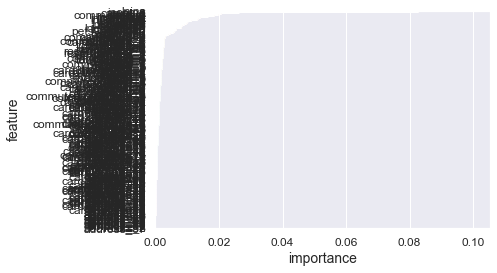

In [48]:
# Create data frame with selected features
indices = np.argsort(radm_clf.feature_importances_)[::-1]
feature_rank = pd.DataFrame( columns = ['rank', 'feature', 'importance'] )
for f in range(train_x.shape[1]):
  feature_rank.loc[f] = [f+1,
                         train_x.columns[indices[f]],
                         radm_clf.feature_importances_[indices[f]]]
sns.barplot( y = 'feature', x = 'importance', data = feature_rank )

In [49]:
# use this since graph above is not clear
indices = np.argsort(radm_clf.feature_importances_)[::-1]
feature_rank = pd.DataFrame( columns = ['rank', 'feature', 'importance'] )
for f in range(train_x.shape[1]):
  feature_rank.loc[f] = [f+1,
                         train_x.columns[indices[f]],
                         radm_clf.feature_importances_[indices[f]]]

feature_rank

,rank,feature,importance
0,1,lninc,0.100371
1,2,income,0.082503
2,3,card_3,0.031112
3,4,carvalue,0.026210
4,5,card_4,0.020652
...,...,...,...
383,384,employ_51,0.000000
384,385,employ_52,0.000000
385,386,cars_8,0.000000
386,387,address_52,0.000000


In [50]:
feature_rank.head(19) 
#more than 0.01 importance

,rank,feature,importance
0,1,lninc,0.100371
1,2,income,0.082503
2,3,card_3,0.031112
3,4,carvalue,0.026210
4,5,card_4,0.020652
5,6,card_2,0.020150
6,7,hourstv,0.019765
7,8,commutetime,0.019030
8,9,reason_2,0.018371
9,10,debtinc,0.018204


In [51]:
slides_f_rank = feature_rank[0:19]
type(slides_f_rank)
slides_f_rank["feature"].replace({"lninc": "Log_income", "income": "Household_income_in_thousands", "card_3": "MasterCard", "card_2": "Visa", 
                                  "carvalue": "Primary_vehicle_sticker_price", "card_4": "Discover", "reason_2": "Convinience", 
                                  "commutetime": "Commute_time_in_minutes", "hourstv": "Hours_spent_watching_tv_last_week", "debtinc": "Debt_to_income_ratio",
                                 "age": "Age_in_years", "creddebt": "Credit_card_debt_in_thousands", "lncreddebt": "Log_credit_card_debt", "ed": "Years_of_education", 
                                  "lncardmon": "Log_calling_card_last_mont", "lnothdebt": "Log_other_debt", "pets": "Number_of_pets_owned", 
                                  "othdebt": "Other_debt_in_thousands", "lncardten": "Log_calling_card_over_tenure"}, inplace=True)
slides_f_rank.head(10)
# log income & household income are co-linear variables

,rank,feature,importance
0,1,Log_income,0.100371
1,2,Household_income_in_thousands,0.082503
2,3,MasterCard,0.031112
3,4,Primary_vehicle_sticker_price,0.026210
4,5,Discover,0.020652
5,6,Visa,0.020150
6,7,Hours_spent_watching_tv_last_week,0.019765
7,8,Commute_time_in_minutes,0.019030
8,9,Convinience,0.018371
9,10,Debt_to_income_ratio,0.018204


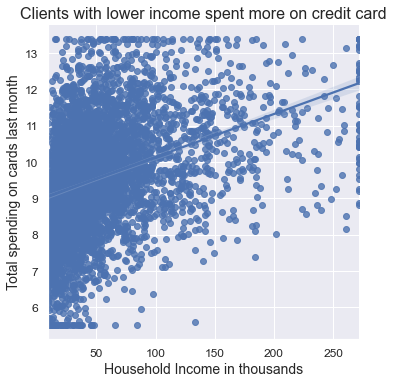

In [52]:
figure1 = sns.lmplot(x = 'income', y = 'bc_totalSpent',  data = customersNew_df)
# figure1.fig.suptitle("Client with lower income spent more on credit card", fontsize=15)
plt.title('Clients with lower income spent more on credit card', y=1.0, fontsize = 16)

figure1.set_axis_labels(y_var = "Total spending on cards last month", x_var = "Household Income in thousands")

In [371]:
customersNew_df.head(2)

,age,ed,income,lninc,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,spoused,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,carvalue,commutetime,tenure,longmon,lnlongmon,longten,lnlongten,tollmon,lntollmon,tollten,lntollten,equipmon,lnequipmon,equipten,lnequipten,cardmon,lncardmon,cardten,lncardten,wiremon,lnwiremon,wireten,lnwireten,hourstv,region_2,region_3,region_4,region_5,townsize_2.0,townsize_3.0,townsize_4.0,townsize_5.0,gender_1,agecat_3,agecat_4,agecat_5,agecat_6,edcat_2,edcat_3,edcat_4,edcat_5,jobcat_2,jobcat_3,jobcat_4,jobcat_5,jobcat_6,union_1,employ_1,employ_2,employ_3,employ_4,employ_5,employ_6,employ_7,employ_8,employ_9,employ_10,employ_11,employ_12,employ_13,employ_14,employ_15,employ_16,employ_17,employ_18,employ_19,employ_20,employ_21,employ_22,employ_23,employ_24,employ_25,employ_26,employ_27,employ_28,employ_29,employ_30,employ_31,employ_32,employ_33,employ_34,employ_35,employ_36,employ_37,employ_38,employ_39,employ_40,employ_41,employ_42,employ_43,employ_44,employ_45,employ_46,employ_47,employ_48,employ_49,employ_51,employ_52,empcat_2,empcat_3,empcat_4,empcat_5,retire_1,inccat_2,inccat_3,inccat_4,inccat_5,default_1,jobsat_2,jobsat_3,jobsat_4,jobsat_5,marital_1,spousedcat_1,spousedcat_2,spousedcat_3,spousedcat_4,spousedcat_5,homeown_1,hometype_2,hometype_3,hometype_4,address_1,address_2,address_3,address_4,address_5,address_6,address_7,address_8,address_9,address_10,address_11,address_12,address_13,address_14,address_15,address_16,address_17,address_18,address_19,address_20,address_21,address_22,address_23,address_24,address_25,address_26,address_27,address_28,address_29,address_30,address_31,address_32,address_33,address_34,address_35,address_36,address_37,address_38,address_39,address_40,address_41,address_42,address_43,address_44,address_45,address_46,address_47,address_48,address_49,address_50,address_51,address_52,address_53,address_54,address_55,address_57,addresscat_2,addresscat_3,addresscat_4,addresscat_5,cars_1,cars_2,cars_3,cars_4,cars_5,cars_6,cars_7,cars_8,carown_0,carown_1,cartype_0,cartype_1,carcatvalue_1,carcatvalue_2,carcatvalue_3,carbought_0,carbought_1,carbuy_1,commute_2,commute_3,commute_4,commute_5,commute_6,commute_7,commute_8,commute_9,commute_10,commutecat_2,commutecat_3,commutecat_4,commutecat_5,commutecar_1,commutemotorcycle_1,commutecarpool_1,commutebus_1,commuterail_1,commutepublic_1,commutebike_1,commutewalk_1,commutenonmotor_1,telecommute_1,reason_2,reason_3,reason_4,reason_9,polview_2,polview_3,polview_4,polview_5,polview_6,polview_7,polparty_1,polcontrib_1,vote_1,card_2,card_3,card_4,card_5,cardtype_2,cardtype_3,cardtype_4,cardbenefit_2,cardbenefit_3,cardbenefit_4,cardfee_1,cardtenure_1,cardtenure_2,cardtenure_3,cardtenure_4,cardtenure_5,cardtenure_6,cardtenure_7,cardtenure_8,cardtenure_9,cardtenure_10,cardtenure_11,cardtenure_12,cardtenure_13,cardtenure_14,cardtenure_15,cardtenure_16,cardtenure_17,cardtenure_18,cardtenure_19,cardtenure_20,cardtenure_21,cardtenure_22,cardtenure_23,cardtenure_24,cardtenure_25,cardtenure_26,cardtenure_27,cardtenure_28,cardtenure_29,cardtenure_30,cardtenure_31,cardtenure_32,cardtenure_33,cardtenure_34,cardtenure_35,cardtenure_36,cardtenure_37,cardtenure_38,cardtenure_39,cardtenure_40,cardtenurecat_2,cardtenurecat_3,cardtenurecat_4,cardtenurecat_5,card2_2,card2_3,card2_4,card2_5,card2type_2,card2type_3,card2type_4,card2benefit_2,card2benefit_3,card2benefit_4,card2fee_1,card2tenure_1,card2tenure_2,card2tenure_3,card2tenure_4,card2tenure_5,card2tenure_6,card2tenure_7,card2tenure_8,card2tenure_9,card2tenure_10,card2tenure_11,card2tenure_12,card2tenure_13,card2tenure_14,card2tenure_15,card2tenure_16,card2tenure_17,card2tenure_18,card2tenure_19,card2tenure_20,card2tenure_21,card2tenure_22,card2tenure_23,card2tenure_24,card2tenure_25,card2tenure_26,card2tenure_27,card2tenure_28,card2tenure_29,card2tenure_30,card2tenurecat_2,card2tenurecat_3,card2tenurecat_4,card2tenurecat_5,active_1,bfast_2,bfast_3,churn_1

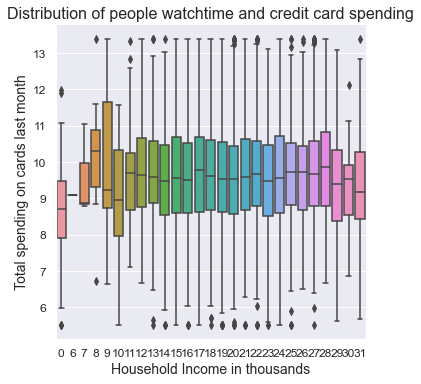

In [90]:
figure2 = sns.catplot(x = 'hourstv', y = 'bc_totalSpent',  kind='box', data = customersNew_df)
plt.title('Distribution of people watchtime and credit card spending', y=1.0, fontsize = 16)

figure2.set_axis_labels(y_var = "Total spending on cards last month", x_var = "Household Income in thousands")

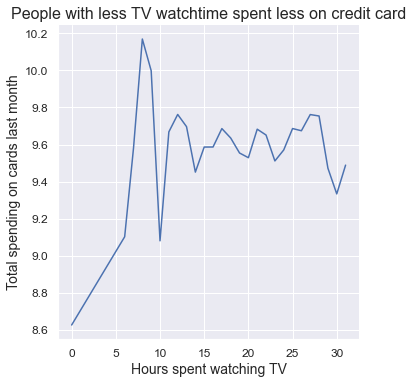

In [54]:
figure3 = sns.relplot(x = 'hourstv', y = 'bc_totalSpent',  kind='line', estimator=np.mean , ci=None, data = customersNew_df)
# use median because from boxplot plotted, a lot of outliers detected
plt.title('People with less TV watchtime spent less on credit card', y=1.0, fontsize = 16)
# plt.ylim([5, 14])
# plt.xlim([0, 31])

figure3.set_axis_labels(y_var = "Total spending on cards last month", x_var = "Hours spent watching TV")

In [56]:
NewCustomers_df=customersNew_df

In [57]:

slides_hoursTV = NewCustomers_df[['bc_totalSpent','hourstv']]
slides_hoursTV = slides_hoursTV.sort_values(by = ['bc_totalSpent','hourstv'], ascending = False)
slides_hoursTV.columns = ['Total_spending_last_month', 'Hours_spent_watching_TV']

slides_hoursTV.describe()

,Total_spending_last_month,Hours_spent_watching_TV
count,5000.000000,5000.00000
mean,9.591980,19.62660
std,1.514853,5.11922
min,5.515125,0.00000
25%,8.639941,17.00000
50%,9.573471,20.00000
75%,10.540247,23.00000
max,13.387154,31.00000


In [58]:
TV_max_min = slides_hoursTV.iloc[[0, -1]]

display(TV_max_min.set_axis(['MAX', 'MIN'], axis=0))

,Total_spending_last_month,Hours_spent_watching_TV
MAX,13.387154,31
MIN,5.515125,0


In [59]:
#Select features and then convert it into list
x=feature_rank.loc[0:75,['feature']]
x=x['feature'].tolist()
print(x)

['Log_income', 'Household_income_in_thousands', 'MasterCard', 'Primary_vehicle_sticker_price', 'Discover', 'Visa', 'Hours_spent_watching_tv_last_week', 'Commute_time_in_minutes', 'Convinience', 'Debt_to_income_ratio', 'Age_in_years', 'Log_other_debt', 'Log_credit_card_debt', 'Credit_card_debt_in_thousands', 'Other_debt_in_thousands', 'Log_calling_card_last_mont', 'Years_of_education', 'Number_of_pets_owned', 'cardmon', 'tenure', 'card_5', 'lntollmon', 'spoused', 'lnlongmon', 'lnlongten', 'lncardten', 'cardten', 'reside', 'longmon', 'longten', 'lnequipmon', 'lnequipten', 'lnwiremon', 'tollmon', 'lntollten', 'pets_freshfish', 'tollten', 'card2_3', 'card2_2', 'equipmon', 'pets_dogs', 'pets_cats', 'lnwireten', 'gender_1', 'equipten', 'commutebus_1', 'carbought_1', 'wiremon', 'vote_1', 'card2type_4', 'card2_4', 'cardtype_2', 'commutewalk_1', 'card2type_3', 'card2benefit_4', 'cardtype_4', 'ownfax_1', 'cardtype_3', 'townsize_2.0', 'region_5', 'jobsat_4', 'carown_0', 'owngame_1', 'callid_1', '

In [60]:
# Create data frame with selected features
rf_features=['income', 'lninc', 'card_3', 'card_2', 'carvalue', 'card_4', 'commutetime', 'reason_2', 'debtinc', 'hourstv', 'creddebt', 'age', 'lncreddebt', 'tenure', 'lncardmon', 'lnothdebt', 'ed', 'othdebt', 'pets', 'lncardten', 'lntollmon', 'cardmon', 'longmon', 'card_5', 'lnlongmon', 'reside', 'spoused', 'cardten', 'lntollten', 'lnequipmon', 'lnlongten', 'tollten', 'longten', 'tollmon', 'lnwiremon', 'card2_2', 'card2_3', 'pets_freshfish', 'lnequipten', 'gender_1', 'pets_dogs', 'equipten', 'wireten', 'pets_cats', 'address_22', 'equipmon', 'wiremon', 'jobsat_4', 'commutebus_1', 'card2benefit_4']

rf_features.append('bc_totalSpent')

df_rf= customersNew_df[rf_features]

df_rf.head(5)


,income,lninc,card_3,card_2,carvalue,card_4,commutetime,reason_2,debtinc,hourstv,creddebt,age,lncreddebt,tenure,lncardmon,lnothdebt,ed,othdebt,pets,lncardten,lntollmon,cardmon,longmon,card_5,lnlongmon,reside,spoused,cardten,lntollten,lnequipmon,lnlongten,tollten,longten,tollmon,lnwiremon,card2_2,card2_3,pets_freshfish,lnequipten,gender_1,pets_dogs,equipten,wireten,pets_cats,address_22,equipmon,wiremon,jobsat_4,commutebus_1,card2benefit_4,bc_totalSpent
0,31.0,3.433987,1,0,14.3,0,22.0,0,11.1,13,1.200909,20,0.183079,5,2.656757,0.806516,15,2.240091,0,4.094345,3.367296,14.25,6.50,0,1.871802,3,-1,60.0,5.081715,3.384390,3.538057,161.05,34.40,29.0,3.604226,0,0,0,4.837075,1,0,126.1,0.00,0,0,29.50,0.00,0,0,0,7.323447
1,15.0,2.708050,0,1,6.8,0,29.0,0,18.6,18,1.222020,22,0.200505,39,2.772589,0.449788,17,1.567980,6,6.413459,3.242727,16.00,8.90,0,2.186051,2,-1,610.0,6.585937,4.004602,5.800909,0.00,330.60,0.0,3.821004,0,0,6,7.588324,0,0,1975.0,1683.55,0,0,54.85,45.65,0,1,0,6.039640
2,35.0,3.555348,0,1,18.8,0,24.0,1,9.9,21,0.928620,67,-0.074056,65,3.135494,0.930738,14,2.536380,3,7.251345,3.242727,23.00,28.40,0,3.346389,3,13,1410.0,6.585937,3.599725,7.527444,0.00,1858.35,0.0,3.604226,0,0,0,6.747846,1,1,0.0,0.00,2,0,0.00,0.00,1,1,0,9.243615
3,20.0,2.995732,0,1,8.7,0,38.0,0,5.7,26,0.033160,23,-3.401690,36,3.044522,0.110826,16,1.117200,0,6.529419,3.242727,21.00,6.00,0,1.791759,5,18,685.0,6.585937,3.599725,5.295564,0.00,199.45,0.0,3.604226,0,1,0,6.747846,0,0,0.0,0.00,0,0,0.00,0.00,0,0,1,9.239995
4,23.0,3.135494,0,0,10.6,1,32.0,0,1.7,27,0.214659,26,-1.538705,21,2.847812,-1.735336,16,0.176341,0,5.886104,2.803360,17.25,3.05,0,1.115142,4,13,360.0,5.960232,3.599725,4.305416,387.70,74.10,16.5,2.947067,0,0,0,6.747846,0,0,0.0,410.80,0,0,0.00,19.05,0,0,0,10.063778


In [61]:
df_rf.shape

(5000, 51)

### 5.2 Find multicolinearlity

In [62]:
import statsmodels as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from patsy import dmatrices

In [63]:
del rf_features[-1]

In [64]:
%%capture
#gather features
features = "+".join(rf_features)

In [65]:
features

'income+lninc+card_3+card_2+carvalue+card_4+commutetime+reason_2+debtinc+hourstv+creddebt+age+lncreddebt+tenure+lncardmon+lnothdebt+ed+othdebt+pets+lncardten+lntollmon+cardmon+longmon+card_5+lnlongmon+reside+spoused+cardten+lntollten+lnequipmon+lnlongten+tollten+longten+tollmon+lnwiremon+card2_2+card2_3+pets_freshfish+lnequipten+gender_1+pets_dogs+equipten+wireten+pets_cats+address_22+equipmon+wiremon+jobsat_4+commutebus_1+card2benefit_4'

In [67]:
# get y and X dataframes based on this regression:
y, X = dmatrices('bc_totalSpent~' + features,df_rf, return_type='dataframe')

In [68]:
# For each X, calculate VIF and save in dataframe
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
vif["features"] = X.columns

In [69]:
vif.sort_values(by=['VIF Factor'],ascending=False).head(3)

,VIF Factor,features
0,1686.859676,Intercept
23,148.928795,longmon
33,117.386519,longten


In [70]:
#Select only those features whose Vif is greater than 10.
vif1=vif[vif['VIF Factor']>10].reset_index().loc[:,['features']]
vif1.drop([0],axis=0,inplace=True)
drop_vars= vif1["features"].tolist()
drop_vars

['tenure',
 'pets',
 'cardmon',
 'longmon',
 'lnlongmon',
 'cardten',
 'lnlongten',
 'tollten',
 'longten',
 'tollmon',
 'pets_freshfish',
 'equipten',
 'wireten',
 'equipmon',
 'wiremon']

In [71]:
# dropping variables that have VIF greater than 10
df_rf.drop(drop_vars,axis=1,inplace=True)

In [72]:
df_rf.shape

(5000, 36)

### 5.3 - All x variables should have a linear relationship with Y

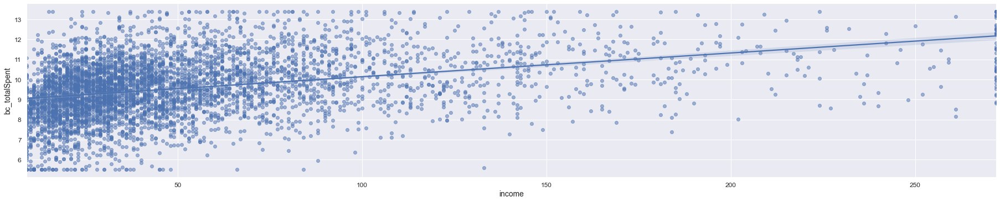

In [73]:
sns.lmplot(x="income",y="bc_totalSpent",data=df_rf,aspect=5,scatter_kws={'alpha':0.5})

### 5.4 Splitting data for training and testing

In [74]:
# Dropping variables one at a time which have p-values greater than 5%
feature_columns=df_rf.columns.difference(['bc_totalSpent','address_22','pets_cats','lncardmon','lnequipten','spoused'
                                         ,'creddebt','reside','othdebt','debtinc','lnothdebt','jobsat_4','income','carvalue',
                                         'card2benefit_4','commutebus_1','hourstv','lnwiremon','pets_dogs','lncardten',
                                         'commutetime','lntollten','lntollmon','lnequipmon'])



In [75]:
# split training and test sets
train_x,test_x,train_y,test_y=train_test_split(df_rf[feature_columns],
                                              df_rf['bc_totalSpent'],
                                               test_size=.2,
                                               random_state=123)

### Build Regression model using statsmodels.api

In [76]:
import statsmodels.api as sm

In [77]:
train_x = sm.add_constant(train_x)
test_x=sm.add_constant(test_x)
lm=sm.OLS(train_y,train_x).fit()

In [78]:
print(lm.summary())

                            OLS Regression Results                            
Dep. Variable:          bc_totalSpent   R-squared:                       0.325
Model:                            OLS   Adj. R-squared:                  0.323
Method:                 Least Squares   F-statistic:                     159.7
Date:                Fri, 29 Oct 2021   Prob (F-statistic):               0.00
Time:                        16:33:32   Log-Likelihood:                -6598.7
No. Observations:                4000   AIC:                         1.322e+04
Df Residuals:                    3987   BIC:                         1.331e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          8.2401      0.172     47.920      0.0

In [79]:
lm.pvalues.sort_values(ascending=False)

lncreddebt     4.587652e-02
ed             1.887734e-02
age            2.357317e-04
gender_1       2.078595e-04
card2_3        1.303811e-11
card2_2        2.408523e-13
reason_2       3.210677e-18
card_5         4.947424e-20
card_3         1.090372e-80
card_2         3.707597e-81
card_4         3.890899e-93
lninc         2.235273e-115
const          0.000000e+00
dtype: float64

In [80]:
print('Parameters:', lm.params) # Find the parameters of x i.e Beta value
print('R2: ', lm.rsquared) # Find the r**2

Parameters: const         8.240115
age          -0.004194
card2_2      -0.379415
card2_3      -0.345223
card_2       -1.243274
card_3       -1.239082
card_4       -1.269314
card_5       -0.992801
ed           -0.015444
gender_1     -0.148872
lncreddebt    0.039624
lninc         0.809044
reason_2      0.707096
dtype: float64
R2:  0.32469503376997044


## 6. Evaluate Model

In [81]:
test_pred=lm.predict(test_x)
train_pred=lm.predict(train_x)

from sklearn import metrics

print('MSE Test:',metrics.mean_squared_error(test_y,test_pred))
print('MSE Train:',metrics.mean_squared_error(train_y,train_pred))


MSE Test: 1.5275402326420058
MSE Train: 1.5864407706604728


In [82]:
# Print MAE, MSE, and RMSE for Predicted vs Actual

print ('MAE:', metrics.mean_absolute_error(test_y, test_pred))
print ('MSE:', metrics.mean_squared_error(test_y, test_pred))
print ('RMSE:', np.sqrt(metrics.mean_squared_error(test_y, test_pred)))

MAE: 0.9762061173805189
MSE: 1.5275402326420058
RMSE: 1.2359369857084161


In [83]:
# https://pkg.robjhyndman.com/forecast/reference/accuracy.html
    
MAPE_train = '%.3f' % np.mean(np.abs(train_y-train_pred)/(train_y))
MAPE_test = '%.3f' % np.mean(np.abs(test_y-test_pred)/(test_y))

# print the values of MAPE for train and test
print('MAPE of training data: ', MAPE_train,  ' | ', 'MAPE of testing data: ', MAPE_test)

MAPE of training data:  0.110  |  MAPE of testing data:  0.106


### 6.1 Check Normality and Residuals

***We will use Q-Q plot to examine this***

<AxesSubplot:ylabel='Density'>

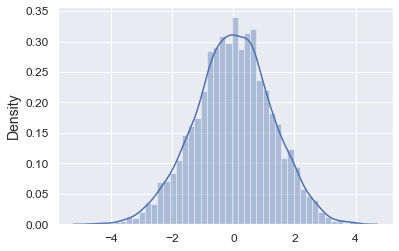

In [84]:
residuals=train_y-train_pred

import seaborn as sns

sns.distplot(residuals)

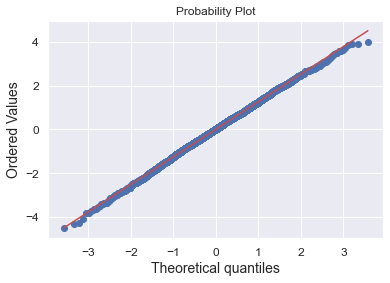

In [85]:
from scipy import stats
import pylab

stats.probplot(residuals,dist='norm',plot=pylab)
pylab.show()

***From the above histogram and Q-Q plot, shows that the residuals are normally distributed, so our  assumption is not violated***

### 6.2 Predicting sales:

***We are going to predict credit card sales on Testing data***

In [86]:
df_rf=df_rf[feature_columns]

df_rf=sm.add_constant(df_rf)

df_rf.head()

,const,age,card2_2,card2_3,card_2,card_3,card_4,card_5,ed,gender_1,lncreddebt,lninc,reason_2
0,1.0,20,0,0,0,1,0,0,15,1,0.183079,3.433987,0
1,1.0,22,0,0,1,0,0,0,17,0,0.200505,2.708050,0
2,1.0,67,0,0,1,0,0,0,14,1,-0.074056,3.555348,1
3,1.0,23,0,1,1,0,0,0,16,0,-3.401690,2.995732,0
4,1.0,26,0,0,0,0,1,0,16,0,-1.538705,3.135494,0


In [87]:
# Final prediction on test file

from scipy.special import boxcox, inv_boxcox

pred_total_spend=inv_boxcox(lm.predict(df_rf),fitted_lambda)
pred_total_spend=pd.DataFrame(pred_total_spend.tolist())
pred_total_spend.columns = ['pred_total_spend']


#Concatenating final prediction with original test file
  
testfile = pd.concat([customers_df, pred_total_spend], axis=1)

testfile.head()

,region,townsize,gender,age,agecat,ed,edcat,jobcat,union,employ,empcat,retire,income,lninc,inccat,debtinc,creddebt,lncreddebt,othdebt,lnothdebt,default,jobsat,marital,spoused,spousedcat,reside,pets,pets_cats,pets_dogs,pets_birds,pets_reptiles,pets_small,pets_saltfish,pets_freshfish,homeown,hometype,address,addresscat,cars,carown,cartype,carvalue,carcatvalue,carbought,carbuy,commute,commutecat,commutetime,commutecar,commutemotorcycle,commutecarpool,commutebus,commuterail,commutepublic,commutebike,commutewalk,commutenonmotor,telecommute,reason,polview,polparty,polcontrib,vote,card,cardtype,cardbenefit,cardfee,cardtenure,cardtenurecat,card2,card2type,card2benefit,card2fee,card2tenure,card2tenurecat,active,bfast,tenure,churn,longmon,lnlongmon,longten,lnlongten,tollfree,tollmon,lntollmon,tollten,lntollten,equip,equipmon,lnequipmon,equipten,lnequipten,callcard,cardmon,lncardmon,cardten,lncardten,wireless,wiremon,lnwiremon,wireten,lnwireten,multline,voice,pager,internet,callid,callwait,forward,confer,ebill,owntv,hourstv,ownvcr,owndvd,owncd,ownpda,ownpc,ownipod,owngame,ownfax,news,response_01,response_02,response_03,totalSpent,pred_total_spend
0,1,2.0,1,20,2,15,3,1,1,0,1,0,31,3.433987,2,11.1,1.200909,0.183079,2.240091,0.806516,1,1,0,-1,-1,3,0,0,0,0,0,0,0,0,0,2,0,1,2,1,0,14.3,1,0,0,8,4,22.0,0,1,1,0,0,0,0,1,0,0,9,6,1,0,1,3,1,1,0,2,2,5,3,1,0,3,2,0,3,5,1,6.50,1.871802,34.40,3.538057,1,29.0,3.367296,161.05,5.081715,1,29.50,3.384390,126.1,4.837075,1,14.25,2.656757,60.0,4.094345,0,0.00,NaN,0.00,NaN,1,1,1,0,0,1,1,1,0,1,13,1,1,0,0,0,1,1,0,0,0,1,0,149.46,372.303626
1,5,5.0,0,22,2,17,4,2,0,0,1,0,15,2.708050,1,18.6,1.222020,0.200505,1.567980,0.449788,1,1,0,-1,-1,2,6,0,0,0,0,0,0,6,1,3,2,1,2,1,1,6.8,1,0,0,1,1,29.0,1,0,0,1,0,0,1,0,1,1,9,4,1,0,0,2,4,1,0,4,2,4,1,3,0,4,2,1,1,39,0,8.90,2.186051,330.60,5.800909,0,0.0,NaN,0.00,NaN,1,54.85,4.004602,1975.0,7.588324,1,16.00,2.772589,610.0,6.413459,1,45.65,3.821004,1683.55,7.428660,1,1,1,4,1,0,1,0,1,1,18,1,1,1,1,1,1,1,1,1,0,0,0,77.54,302.061632
2,3,4.0,1,67,6,14,2,2,0,16,5,0,35,3.555348,2,9.9,0.928620,-0.074056,2.536380,0.930738,0,4,1,13,2,3,3,2,1,0,0,0,0,0,1,1,30,5,3,1,1,18.8,1,0,1,4,3,24.0,1,0,1,1,1,0,0,0,0,0,2,5,1,0,0,2,1,4,0,35,5,4,1,3,0,25,5,0,3,65,0,28.40,3.346389,1858.35,7.527444,0,0.0,NaN,0.00,NaN,0,0.00,NaN,0.0,NaN,1,23.00,3.135494,1410.0,7.251345,0,0.00,NaN,0.00,NaN,1,0,0,0,0,0,0,0,0,1,21,1,1,1,0,0,0,0,0,1,0,0,0,359.97,480.932946
3,4,3.0,0,23,2,16,3,2,0,0,1,0,20,2.995732,1,5.7,0.022800,-3.780995,1.117200,0.110826,1,2,1,18,4,5,0,0,0,0,0,0,0,0,1,3,3,2,3,1,1,8.7,1,0,1,1,1,38.0,1,0,0,0,0,0,0,0,0,0,9,3,0,0,0,2,1,4,0,5,2,3,2,4,0,5,2,1,1,36,0,6.00,1.791759,199.45,5.295564,0,0.0,NaN,0.00,NaN,0,0.00,NaN,0.0,NaN,1,21.00,3.044522,685.0,6.529419,0,0.00,NaN,0.00,NaN,1,0,0,2,0,0,0,0,1,1,26,1,1,1,0,1,1,1,0,1,1,0,0,359.41,271.020145
4,2,2.0,0,26,3,16,3,2,0,1,1,0,23,3.135494,1,1.7,0.214659,-1.538705,0.176341,-1.735336,0,1,1,13,2,4,0,0,0,0,0,0,0,0,0,2,3,2,1,0,1,10.6,1,0,1,6,3,32.0,0,0,0,0,0,1,0,1,0,0,9,4,0,0,0,4,2,1,0,8,3,1,3,2,0,9,3,1,3,21,0,3.05,1.115142,74.10,4.305416,1,16.5,2.803360,387.70,5.960232,0,0.00,NaN,0.0,NaN,1,17.25,2.847812,360.0,5.886104,1,19.05,2.947067,410.80,6.018106,0,1,0,3,1,1,1,1,0,1,27,1,1,1,0,1,0,1,0,0,0,1,0,507.83,336.914886


In [88]:
#Export the final result in csv.
testfile.to_csv('Group2_Final_submission_credit_spend.csv',index=False)
